In this notebook, we are going to perform simultaneous instance segmentation and tracking on the Fluo-N2DH-SIM+ dataset:
- Ulman & Svoboda, [Simulated nuclei of HL60 cells stained with Hoescht Fluo-N2DH-SIM+](http://celltrackingchallenge.net/2d-datasets/)

For this, we are going to adapt the EmbedTrack approach from Löffler et al.:
- [Löffler & Mikut, EmbedTrack – Simultaneous Cell Segmentation
and Tracking Through Learning Offsets and Clustering Bandwidths. **2022**](https://arxiv.org/pdf/2204.10713.pdf)

For instance segmentation EmbedTrack adapts work from Neven et al.:
- [Neven et al., Instance Segmentation by Jointly Optimizing Spatial Embeddings and Clustering Bandwidth. **2019**](https://arxiv.org/pdf/1906.11109.pdf)

In [1]:
!pip install pytorch_lightning
!pip install httpimport
!pip install imagecodecs

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 801.6/801.6 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 841.5/841.5 kB 34.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 39.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 52.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 29.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 6.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━

In [2]:
import ssl
import zipfile
import urllib
import os
import glob
from skimage import io as skio
import matplotlib.pyplot as plt
from matplotlib import colors as mpl_colors
from PIL import Image
import io
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from torch.nn import Conv2d, ReLU, BatchNorm2d, MaxPool2d, Upsample
import pytorch_lightning as pl
from pytorch_lightning.callbacks import (
    ModelCheckpoint, EarlyStopping, LearningRateMonitor)
from pytorch_lightning.loggers import CSVLogger
import numpy as np
from scipy.spatial import distance_matrix
import math
import pickle
import albumentations as A
from joblib import Parallel, delayed
import pandas as pd
from pathlib import Path
from copy import deepcopy
from scipy.stats import median_abs_deviation
from IPython.core.interactiveshell import InteractiveShell
from IPython import display
import httpimport
import logging
with httpimport.github_repo("kaloeffler", "EmbedTrack", ref="master"):
    import embedtrack.criterions.lovasz_losses as losses

plt.rcParams["figure.dpi"] = 300
plt.rcParams["axes.labelsize"] = 4
plt.rcParams["xtick.labelsize"] = 3
plt.rcParams["ytick.labelsize"] = 3
plt.rcParams["xtick.major.size"] = 2
plt.rcParams["ytick.major.size"] = 2

logging.getLogger("pytorch_lightning").setLevel(logging.WARNING)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

ssl._create_default_https_context = ssl._create_unverified_context
dir_trainval = "./data/trainval/"
dir_test = "./data/test/"
url_trainval = "http://data.celltrackingchallenge.net/training-datasets/Fluo-N2DH-SIM+.zip"
url_test = "http://data.celltrackingchallenge.net/test-datasets/Fluo-N2DH-SIM+.zip"

# Hyperparameters
# Data
resized_shape = (1, 384, 384)
train_ratio = 0.8

# Model
contractions = 6
filter_init = 24

# Training
batch_size = 6
accumulate_grad_batches = 2
epochs = 200
patience_early_stopping = 80

# Loss function
w_fg = 2
w_s_train = -10
w_instance = 8
w_var = 20
w_seed = 0.3
w_track = 1

# Postprocessing
min_mask_size_percentile = 1
seedines_cutoff = 0.6
min_peaks = 9
w_s_post = -20

# Learning rate scheduler
lr_after_warmup = 9e-4
lr_decay = 0.98
lr_max = lr_after_warmup * 1
lr_min = 5e-7
warmup_epochs = 10
f_reduction = 0.25
f_restart = 1.0
patience = 4
min_loss_improvement = 0.002
no_of_restarts_init = 1
increment_no_of_restarts = 1

Let's download and unzip the dataset:

In [3]:
zip_path, _ = urllib.request.urlretrieve(url_trainval)
with zipfile.ZipFile(zip_path, "r") as f:
    f.extractall(dir_trainval)

zip_path, _ = urllib.request.urlretrieve(url_test)
with zipfile.ZipFile(zip_path, "r") as f:
    f.extractall(dir_test)

Now we will perform some data preprocessing. In EmbedTrack for instance segmentation, we predict for each pixel the offset to the instance medoid. If this prediction falls into a learnable bandwith around the true instance medoid that pixels is associated to the instance. Therefore, we need to know the medoid of each instance. Because it is computationally demanding to calculated this medoid on-the-fly during training, we will precalculate it below and then only load these precalculated medoids during training. Furthermore, the cell below contains code to create a gif animation for the two sequences in the training data:

In [4]:
def fig2PngImageFile(fig):
    buf = io.BytesIO()
    fig.savefig(buf, dpi=400, bbox_inches="tight", pad_inches=0)
    buf.seek(0)
    img = Image.open(buf)
    return img


def get_instance_medoids(seg_mask, id_background=0):
    ids_instances = np.unique(seg_mask)
    ids_instances = np.delete(ids_instances, id_background)
    medoids = np.zeros((ids_instances.shape[0], 3), dtype=np.float32)

    for idx, id_instance in enumerate(ids_instances):
        coords = np.stack(np.where(seg_mask == id_instance)).T
        medoids[idx, 0] = id_instance
        medoids[idx, 1:] = coords[np.argmin(np.sum(
            distance_matrix(coords, coords), axis=0)), :]
    return medoids


def preprocess_annotated(fp_img, fp_seg, resized_shape):
    img = skio.imread(fp_img)
    seg = skio.imread(fp_seg)

    # Resize image and mask
    transform = A.Compose([
        A.Resize(resized_shape[1], resized_shape[2]),
        ], additional_targets={"seg": "mask"})
    transformed = transform(image=img, seg=seg)
    img = transformed["image"]
    seg = transformed["seg"]

    # Normalize image
    min_img, max_img = np.quantile(img, [0.01, 0.99])
    img = ((img - min_img) / (max_img - min_img)).astype(np.float32)
    img = np.clip(img, 0, 1)

    # Get medoids
    medoids = get_instance_medoids(seg)
    return img, seg, medoids


def annotate_medoids(ax, medoids, w, h, fontsize):
    for id_cur, y, x in medoids:
        ax.annotate(
            text=f"{int(id_cur)}", xycoords="axes fraction",
            xy=(x / w, 1 - (y / h)), color="red", size=fontsize,
            horizontalalignment="center", verticalalignment="center")
    return ax


def create_plot(img, seg, colors_rgb, medoids=None, idx_frame=None,
                figsize=(3, 1.5), id_fontsize=3):
    fig, ax = plt.subplots(1, 2, figsize=figsize)
    ax[0].imshow(img, cmap="gray", vmin=0, vmax=1)
    ax[1].imshow(colors_rgb[seg])
    if medoids is not None:
        ax[1] = annotate_medoids(
            ax[1], medoids, img.shape[0], img.shape[1], id_fontsize)
    [axi.set_axis_off() for axi in ax.ravel()]
    if idx_frame is not None:
        fig.suptitle(f"Frame {idx_frame}", fontsize=7)
    return fig


def preprocess_and_plot(fp_img, fp_seg, dir_proc, idx_seq, idx_frame,
                        resized_shape):
    img, seg, medoids = preprocess_annotated(fp_img, fp_seg, resized_shape)
    fig = create_plot(img, seg, colors_rgb, medoids, idx_frame)
    plt.close()

    # fps_proc: [img_t0, mask_t0, medoid_t0, img_t1, mask_t1, medoid_t1]
    fps_proc = [dir_proc + x for x in [
        f"seq{idx_seq}_frame{idx_frame}_img.npy",
        f"seq{idx_seq}_frame{idx_frame}_seg.npy",
        f"seq{idx_seq}_frame{idx_frame}_medoid.npy",
        f"seq{idx_seq}_frame{idx_frame+1}_img.npy",
        f"seq{idx_seq}_frame{idx_frame+1}_seg.npy",
        f"seq{idx_seq}_frame{idx_frame+1}_medoid.npy"]]

    np.save(fps_proc[0], np.expand_dims(img, 2))
    np.save(fps_proc[1], np.expand_dims(seg, 2).astype(np.float32))
    np.save(fps_proc[2], medoids)
    return (fig, fps_proc)


dir_trainval_img_seq = [
    dir_trainval + "Fluo-N2DH-SIM+/" + x for x in ["01/", "02/"]]
dir_trainval_seg_seq = [
    dir_trainval + "Fluo-N2DH-SIM+/" + x for x in ["01_GT/TRA/", "02_GT/TRA/"]]

dir_proc = dir_trainval + "proc/"
os.makedirs(dir_proc, exist_ok=True)

# Coloring for animation
colors_names = ["blue", "darkgreen", "magenta", "yellow", "cyan",
                "white", "navy", "darkgrey", "peru", "indigo", "lime"]
colors_rgb = np.vstack((
    np.array([[0, 0, 0]]),
    np.tile(np.array([list(mpl_colors.to_rgba(x)[0:3]) for x in
                      colors_names]), reps=(50, 1))))

fps_train = []
fps_val = []
for idx_seq, (dir_img, dir_seg) in enumerate(
        zip(dir_trainval_img_seq, dir_trainval_seg_seq)):
    fps_img = sorted(glob.glob(dir_img + "*.tif"))
    fps_seg = sorted(glob.glob(dir_seg + "*.tif"))

    out = Parallel(n_jobs=-1)(delayed(preprocess_and_plot)(
        fp_img, fp_seg, dir_proc, idx_seq, idx_frame, resized_shape) for
        idx_frame, (fp_img, fp_seg) in enumerate(zip(fps_img, fps_seg)))
    animation_frames = [fig2PngImageFile(x[0]) for x in out]
    fps_proc = [x[1] for x in out[:-1]]
    fps_train.extend(fps_proc[:int(len(fps_proc) * train_ratio)-1])
    fps_val.extend(fps_proc[int(len(fps_proc) * train_ratio):])

    # Save animation
    animation_frames[0].save(f"./animation_seq_{idx_seq+1}.gif", save_all=True,
                             append_images=animation_frames[0:], fps=10, loop=0)

InteractiveShell.ast_node_interactivity = "all"

Now let's look at the gif animation for the sequence in the training data:

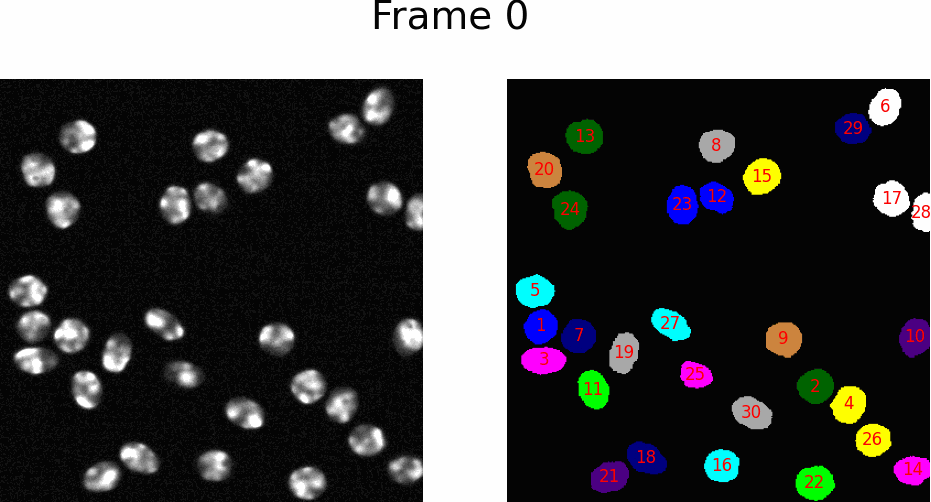

In [5]:
with open("./animation_seq_1.gif", "rb") as f:
    display.Image(data=f.read(), format="gif")

![display image](./animation_seq_1.gif)

And the second sequence:

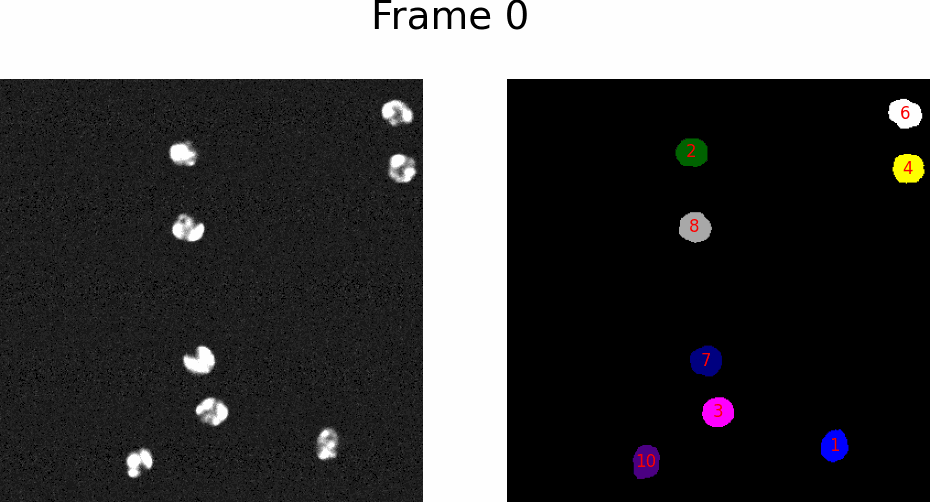

In [6]:
with open("./animation_seq_2.gif", "rb") as f:
    display.Image(data=f.read(), format="gif")
InteractiveShell.ast_node_interactivity = "last_expr"

![display image](./animation_seq_2.gif)

Now, we will create our Pytorch dataset and visualize the dataset to see if the medoids are still correct even after performing some augmentations:

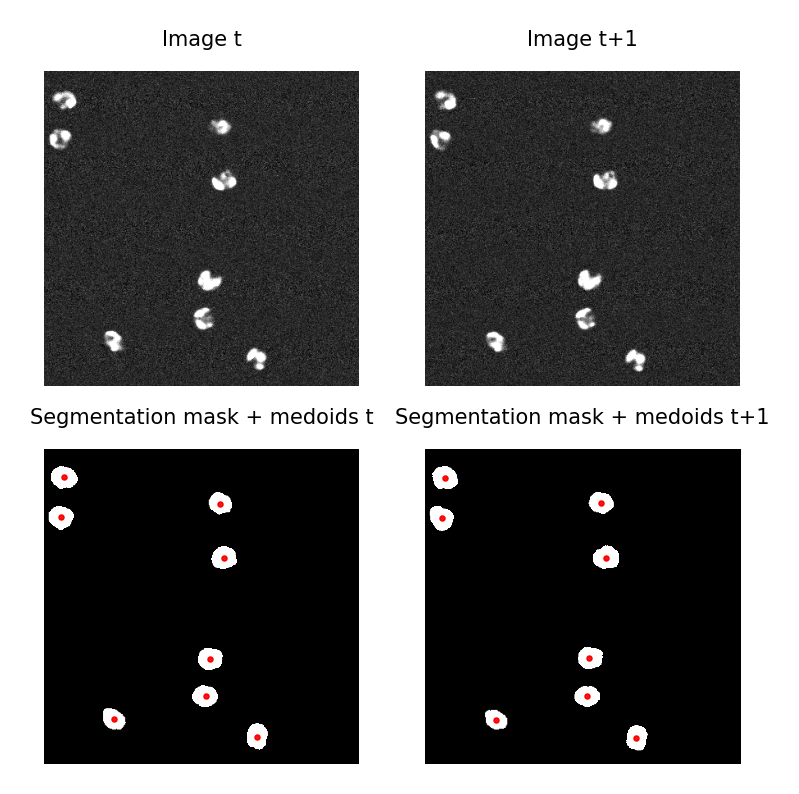

In [7]:
class CustomDataset(Dataset):
    def __init__(self, fps, augment):
        self.fps = fps
        self.augment = augment

    def __len__(self):
        return len(self.fps)

    def __getitem__(self, idx):
        (fp_img0, fp_seg0, fp_medoids0, fp_img1, fp_seg1, fp_medoids1
         ) = self.fps[idx]
        img0, seg0, medoids0 = np.load(fp_img0), np.load(
            fp_seg0), np.load(fp_medoids0)
        img1, seg1, medoids1 = np.load(fp_img1), np.load(
            fp_seg1), np.load(fp_medoids1)

        # Augment
        if self.augment:
            transform = A.Compose([
                A.HorizontalFlip(p=0.3),
                A.VerticalFlip(p=0.3),
                A.OneOf([
                    A.RandomBrightnessContrast(p=1),
                    A.RandomGamma(gamma_limit=(80, 120), p=1),
                    A.Blur(p=1)
                  ], p=0.3),
                ], additional_targets={
                    "seg0": "mask", "img1": "image", "seg1": "mask",
                    "keypoints1": "keypoints"},
                  keypoint_params=A.KeypointParams(format="yx",
                                                   remove_invisible=False))

            transformed = transform(
                image=img0, seg0=seg0, img1=img1, seg1=seg1,
                keypoints=medoids0[:, 1:3], keypoints1=medoids1[:, 1:3])
            img0 = transformed["image"]
            img1 = transformed["img1"]
            seg0 = transformed["seg0"]
            seg1 = transformed["seg1"]
            medoids0 = np.concatenate(
                (medoids0[:, 0:1], np.array(transformed["keypoints"])),
                axis=-1)
            medoids1 = np.concatenate(
                (medoids1[:, 0:1], np.array(transformed["keypoints1"])),
                axis=-1)

        # Conversion numpy -> torch
        img0 = torch.tensor(np.moveaxis(img0, 2, 0)).float()
        img1 = torch.tensor(np.moveaxis(img1, 2, 0)).float()
        seg0 = torch.tensor(np.moveaxis(seg0, 2, 0)).float()
        seg1 = torch.tensor(np.moveaxis(seg1, 2, 0)).float()
        medoids0 = torch.tensor(medoids0).float()
        medoids1 = torch.tensor(medoids1).float()
        return img0, seg0, medoids0, img1, seg1, medoids1


def custom_collate(batch):
    img0 = torch.stack([item[0] for item in batch])
    seg0 = torch.stack([item[1] for item in batch])
    medoids0 = [item[2] for item in batch]
    img1 = torch.stack([item[3] for item in batch])
    seg1 = torch.stack([item[4] for item in batch])
    medoids1 = [item[5] for item in batch]
    return img0, seg0, medoids0, img1, seg1, medoids1


ds_train = CustomDataset(fps_train, augment=True)
loader_train = DataLoader(
    ds_train, batch_size=batch_size, shuffle=True, collate_fn=custom_collate)

ds_val = CustomDataset(fps_val, augment=False)
loader_val = DataLoader(
    ds_val, batch_size=batch_size, shuffle=False, collate_fn=custom_collate)

img0, seg0, medoids0, img1, seg1, medoids1 = next(iter(loader_train))

fig, ax = plt.subplots(2, 2, figsize=(3, 3))
ax[0, 0].imshow(img0[0, 0, :, :], cmap="gray", vmin=0, vmax=1)
ax[0, 0].set_title("Image t", fontsize=5)
ax[0, 1].imshow(img1[0, 0, :, :], cmap="gray", vmin=0, vmax=1)
ax[0, 1].set_title("Image t+1", fontsize=5)

ax[1, 0].imshow(seg0[0, 0, :, :].numpy(), cmap="gray", vmin=0, vmax=1)
ax[1, 0].set_title("Segmentation mask + medoids t", fontsize=5)
for id_cur, y, x in medoids0[0].numpy():
    ax[1, 0].scatter(x, y, color="red", s=0.3)
ax[1, 1].imshow(seg1[0, 0, :, :].numpy(), cmap="gray", vmin=0, vmax=1)
ax[1, 1].set_title("Segmentation mask + medoids t+1", fontsize=5)
for id_cur, y, x in medoids1[0].numpy():
    ax[1, 1].scatter(x, y, color="red", s=0.3)
[axi.set_axis_off() for axi in ax.ravel()]
plt.show()

Now we will construct our model. It is a U-net type model that takes a sequence of two images as input. For each of these two images, we predict 5 masks: x- and y-offset from the medoid, bandwidth in x- and y-direction and seediness. The encoded feature maps from this are furthermore concatenated and passed into a separate decoder that dedicated to the tracking task in that we predict two mask, the x- and y-offset off each pixel to the medoid of the instance this pixel belonged to in the first image:

In [8]:
class UNetBlock(nn.Module):
    def __init__(self, filters_in, filters_out, contract=False,
                 expand=False,
                 codes=None, bottom_shape=None, f_hidden_size_conditional=None):
        super().__init__()
        self.conv1 = Conv2d(
            in_channels=filters_in, out_channels=filters_out,
            kernel_size=3, stride=1, padding=1)
        self.conv2 = Conv2d(
            in_channels=filters_out, out_channels=filters_out,
            kernel_size=3, stride=1, padding=1)
        self.activation = ReLU()
        self.bn1 = BatchNorm2d(filters_out)
        self.bn2 = BatchNorm2d(filters_out)

        self.contract = contract
        self.expand = expand

        if expand:
            self.upsample = Upsample(scale_factor=2, mode="bilinear")

        if contract:
            self.pooling = MaxPool2d((2, 2))

    def forward(self, x, x_skip=None):
        if self.expand:
            x = self.upsample(x)
            if x_skip is not None:
                x = torch.cat([x, x_skip], dim=1)

        x = self.conv1(x)
        x = self.activation(x)
        x = self.bn1(x)

        x = self.conv2(x)
        x = self.activation(x)
        x = self.bn2(x)

        if self.contract:
            return self.pooling(x), x
        else:
            return x


def calc_filter_sizes_for_unet(contractions, filter_init, input_shape, blocks):
    factors = [2**x for x in range(math.ceil(blocks / 2))]
    factors.extend(factors[::-1][1:])

    filters = []
    for idx in range(len(factors)):
        if idx == 0:
            filters.append([input_shape[0], filter_init*factors[idx]])
        elif idx in range(contractions+1):
            filters.append(
                    [filter_init*factors[idx-1], filter_init*factors[idx]])
        else:
            filters.append(
                [filter_init*factors[idx-1] + (filter_init*factors[idx-1]) // 2,
                 filter_init*factors[idx]])
    return filters


class UNetEncoder(nn.Module):
    def __init__(self, contractions, filter_init, input_shape):
        super().__init__()
        self.contractions = contractions
        self.blocks = contractions * 2 + 1
        self.filters = calc_filter_sizes_for_unet(
            contractions, filter_init, input_shape, self.blocks)[:-contractions]

        self.layers = nn.ModuleList()
        for idx, (f_in, f_out) in enumerate(self.filters):
            if idx in range(contractions):
                self.layers.append(UNetBlock(f_in, f_out, contract=True))
            elif idx == contractions:
                self.layers.append(UNetBlock(f_in, f_out))

    def forward(self, x):
        x_skips = []
        for idx, (_, _) in enumerate(self.filters):
            if idx in range(self.contractions):
                x, x_skip = self.layers[idx](x)
                x_skips.append(x_skip)
            elif idx == self.contractions:
                x = self.layers[idx](x)
        return x, x_skips


class UNetDecoder(nn.Module):
    def __init__(self, contractions, filter_init, input_shape):
        super().__init__()
        self.contractions = contractions
        self.blocks = contractions * 2 + 1
        self.filters = calc_filter_sizes_for_unet(
            contractions, filter_init, input_shape, self.blocks)[-contractions:]

        self.layers = nn.ModuleList()
        for idx, (f_in, f_out) in enumerate(self.filters):
            self.layers.append(UNetBlock(f_in, f_out, expand=True))

    def forward(self, x, x_skips):
        for idx, (_, _) in enumerate(self.filters):
            x = self.layers[idx](x, x_skips[-(idx+1)])
        return x


class EmbedTrack(nn.Module):
    def __init__(self, contractions, filter_init, input_shape):
        super().__init__()
        self.encoder = UNetEncoder(
            contractions, filter_init, input_shape)
        self.decoder_seg = UNetDecoder(
            contractions, filter_init, input_shape)
        self.relu = ReLU()

        self.bn_offset0 = BatchNorm2d(filter_init)
        self.conv_offset0 = Conv2d(
            in_channels=filter_init, out_channels=filter_init, kernel_size=3,
            stride=1, padding=1)
        self.conv_offset1 = Conv2d(
            in_channels=filter_init, out_channels=2, kernel_size=3, stride=1,
            padding=1)

        self.bn_bw0 = BatchNorm2d(filter_init)
        self.conv_bw0 = Conv2d(
            in_channels=filter_init, out_channels=filter_init, kernel_size=3,
            stride=1, padding=1)
        self.conv_bw1 = Conv2d(
            in_channels=filter_init, out_channels=2, kernel_size=3, stride=1,
            padding=1)

        self.bn_seed0 = BatchNorm2d(filter_init)
        self.conv_seed0 = Conv2d(
            in_channels=filter_init, out_channels=filter_init, kernel_size=3,
            stride=1, padding=1)
        self.conv_seed1 = Conv2d(
            in_channels=filter_init, out_channels=1, kernel_size=3, stride=1,
            padding=1)

        self.decoder_tra = UNetDecoder(
            contractions, filter_init*2, input_shape)
        self.bn_tra0 = BatchNorm2d(filter_init*2)
        self.conv_tra0 = Conv2d(
            in_channels=filter_init*2, out_channels=filter_init*2,
            kernel_size=3, stride=1, padding=1)
        self.conv_tra1 = Conv2d(
            in_channels=filter_init*2, out_channels=2, kernel_size=3,
            stride=1, padding=1)

    def forward(self, img0, img1):
        x0, x0_skips = self.encoder(img0)
        seg0_dec = self.decoder_seg(x0, x0_skips)
        seg0_offset = self.relu(self.bn_offset0(self.conv_offset0(seg0_dec)))
        seg0_offset = torch.tanh(self.conv_offset1(seg0_offset))
        seg0_bw = self.relu(self.bn_bw0(self.conv_bw0(seg0_dec)))
        seg0_bw = torch.sigmoid(self.conv_bw1(seg0_bw))
        seg0_seed = self.relu(self.bn_seed0(self.conv_seed0(seg0_dec)))
        seg0_seed = torch.sigmoid(self.conv_seed1(seg0_seed))
        seg0 = torch.cat((seg0_offset, seg0_bw, seg0_seed), axis=1)

        x1, x1_skips = self.encoder(img1)
        seg1_dec = self.decoder_seg(x1, x1_skips)
        seg1_offset = self.relu(self.bn_offset0(self.conv_offset0(seg1_dec)))
        seg1_offset = torch.tanh(self.conv_offset1(seg1_offset))
        seg1_bw = self.relu(self.bn_bw0(self.conv_bw0(seg1_dec)))
        seg1_bw = torch.sigmoid(self.conv_bw1(seg1_bw))
        seg1_seed = self.relu(self.bn_seed0(self.conv_seed0(seg1_dec)))
        seg1_seed = torch.sigmoid(self.conv_seed1(seg1_seed))
        seg1 = torch.cat((seg1_offset, seg1_bw, seg1_seed), axis=1)

        x_cat = torch.cat([x0, x1], axis=1)
        x_skip_cat = [torch.cat([x0, x1], axis=1) for (x0, x1) in
                      zip(x0_skips, x1_skips)]
        tra = self.decoder_tra(x_cat, x_skip_cat)
        tra = torch.tanh(
            self.conv_tra1(self.relu(self.bn_tra0(self.conv_tra0(tra)))))
        return seg0, seg1, tra

Now, we will define our loss function:

In [9]:
def calc_var_loss(seg_pred, seg_true, medoid_true, w, h, device):
    l_var = torch.tensor([0], dtype=torch.float32).to(device)
    cmxy = torch.zeros((2, w, h)).to(device)

    for count, (id_instance, x, y) in enumerate(medoid_true):
        cmxy[0][seg_true[0, :, :] == id_instance] = x / w
        cmxy[1][seg_true[0, :, :] == id_instance] = y / h

        sk_idx = torch.stack(torch.where(seg_true[:, :] == id_instance))[1:].mT
        sk = seg_pred[2:4, :, :][:, sk_idx[:, 0], sk_idx[:, 1]].mT
        sm = torch.mean(sk, axis=0, keepdims=True)
        l_var += (sm - sk).pow(2).sum() / sk.shape[0]
    return l_var / (count + 1), cmxy


def calc_instance_loss(seg_pred, seg_true, cmxy, eixy, w_s):
    dm = torch.exp(
        -(cmxy[0, :, :] - eixy[0, :, :]).pow(2) /
        torch.exp(w_s * seg_pred[2, :, :]) -
         (cmxy[1, :, :] - eixy[1, :, :]).pow(2) /
        torch.exp(w_s * seg_pred[3, :, :]))[None, :, :]
    bm = torch.where(seg_true[0, :, :] > 0., 1., 0)[None, :, :]
    return losses.lovasz_hinge(dm * 2 - 1, bm), dm


def calc_seed_loss(seg_pred, seg_true, dm, w_fg):
    bg = seg_true[0, :, :] == 0
    fg = seg_true[0, :, :] != 0
    l_seed = (bg * (seg_pred[4, :, :] - 0)).pow(2).sum() / bg.sum()
    l_seed += w_fg * (
        (fg * (seg_pred[4, :, :] - dm)).pow(2).sum() / fg.sum())
    return l_seed


def custom_loss(seg0_pred, seg1_pred, tra_pred, seg0_true, medoid0_true,
                seg1_true, medoid1_true, device, w_fg, w_s):
    w, h = seg0_pred.shape[2], seg0_pred.shape[3]
    pi = torch.stack(torch.meshgrid(
        torch.arange(w), torch.arange(h), indexing="ij")).float().to(device)
    pi[0, :, :] = pi[0, :, :] / (w-1)
    pi[1, :, :] = pi[1, :, :] / (h-1)
    eixy0 = seg0_pred[:, 0:2, :, :] + pi
    eixy1 = seg1_pred[:, 0:2, :, :] + pi
    eixy2 = tra_pred[:, 0:2, :, :] + pi

    l_var_acc = torch.tensor([0], dtype=torch.float32).to(device)
    l_instance_acc = torch.tensor([0], dtype=torch.float32).to(device)
    l_seed_acc = torch.tensor([0], dtype=torch.float32).to(device)
    l_track_acc = torch.tensor([0], dtype=torch.float32).to(device)

    for idx in range(seg0_pred.shape[0]):
        l_var0, cmxy0 = calc_var_loss(
            seg0_pred[idx], seg0_true[idx], medoid0_true[idx], w, h, device)
        l_var1, cmxy1 = calc_var_loss(
            seg1_pred[idx], seg1_true[idx], medoid1_true[idx], w, h, device)
        l_var_acc += (l_var0 + l_var1)

        # Jaccard
        l_instance0, dm0 = calc_instance_loss(
            seg0_pred[idx], seg0_true[idx], cmxy0, eixy0[idx], w_s)
        l_instance1, dm1 = calc_instance_loss(
            seg1_pred[idx], seg1_true[idx], cmxy1, eixy1[idx], w_s)
        l_instance_acc += l_instance0 + l_instance1

        # Seedines
        l_seed0 = calc_seed_loss(seg0_pred[idx], seg0_true[idx], dm0, w_fg)
        l_seed1 = calc_seed_loss(seg1_pred[idx], seg1_true[idx], dm1, w_fg)
        l_seed_acc += l_seed0 + l_seed1

        # l_track
        l_track, _ = calc_instance_loss(
            seg0_pred[idx], seg0_true[idx], cmxy0, eixy2[idx], w_s)
        l_track_acc += l_track

    l_var_acc /= (idx + 1)
    l_instance_acc /= (idx + 1)
    l_seed_acc /= (idx + 1)
    l_track_acc /= (idx + 1)
    return l_var_acc, l_instance_acc, l_seed_acc, l_track_acc

A custom learning rate scheduler:

In [10]:
class MultiplicativeDecayWithReduceOrRestartOnPlateau:
    def __init__(self, optimizer, lr_after_warmup, lr_decay, lr_max, lr_min,
                 warmup_epochs, f_reduction, f_restart, patience,
                 min_loss_improvement, no_of_restarts_init,
                 increment_no_of_restarts):
        self.optimizer = optimizer
        self.lr_after_warmup = lr_after_warmup
        self.lr_decay = lr_decay
        self.lr_max = lr_max
        self.lr_min = lr_min
        self.warmup_epochs = warmup_epochs
        self.f_reduction = f_reduction
        self.f_restart = f_restart
        self.patience = patience
        self.min_loss_improvement = min_loss_improvement
        self.no_of_restarts_init = no_of_restarts_init
        self.increment_no_of_restarts = increment_no_of_restarts

        self.loss_best = np.Inf
        self.plateau_epochs = 0
        self.reductions_counter = 0
        self.just_restarted = False
        self.set_par("initial_lr", self.lr_min)
        self.set_par("lr", self.lr_min)
        self.epoch = 0

    def get_par(self, name):
        for group in self.optimizer.param_groups: par = group[name]
        return par

    def set_par(self, name, value):
        for group in self.optimizer.param_groups: group[name] = value

    def on_loss_improvement(self, loss_cur):
        self.loss_best = loss_cur
        self.plateau_epochs = 0

    def on_loss_deterioration(self):
        self.plateau_epochs += 1

    def multiplicative_decay_lr(self, lr):
        return lr * self.lr_decay

    def on_plateau(self, lr):
        if self.reductions_counter >= self.no_of_restarts_init:
            lr_new = self.restart_lr()
        else:
            lr_new = self.steep_reduce_lr(lr)
        return lr_new

    def steep_reduce_lr(self, lr):
        lr_new = lr * self.f_reduction
        self.plateau_epochs = 0
        self.reductions_counter += 1
        return lr_new

    def restart_lr(self):
        self.lr_after_warmup *= self.f_restart
        lr_new = self.lr_after_warmup
        if lr_new > self.lr_max:
            lr_new = self.lr_max
        self.plateau_epochs = 0
        self.reductions_counter = 0
        self.no_of_restarts_init += self.increment_no_of_restarts
        self.just_restarted = True
        return lr_new

    def warmup(self):
        lr_new = self.lr_min + (self.lr_after_warmup - self.lr_min) * (
            self.epoch / self.warmup_epochs)
        return lr_new

    def step(self, metrics):
        if self.epoch <= self.warmup_epochs:
            lr_new = self.warmup()
        else:
            lr_cur = self.get_par("lr")
            loss_cur = float(metrics)

            if 1 - (loss_cur / self.loss_best) > self.min_loss_improvement:
                self.on_loss_improvement(loss_cur)
            else:
                self.on_loss_deterioration()
            lr_new = self.multiplicative_decay_lr(lr_cur)

            if self.just_restarted:
                self.loss_best = loss_cur
                self.just_restarted = False

            if self.plateau_epochs >= self.patience:
                lr_new = self.on_plateau(lr_cur)

            if lr_new <= self.lr_min:
                lr_new = self.restart_lr()

        self.set_par("lr", lr_new)
        self.epoch += 1

And let's start training:

In [11]:
cb_a1 = ModelCheckpoint(monitor="val_loss", mode="min")
cb_b1 = EarlyStopping(
    monitor="val_loss", mode="min", patience=patience_early_stopping)
cb_c1 = LearningRateMonitor(logging_interval="epoch")
logger1 = CSVLogger(save_dir="logs/", name="model001",
                    flush_logs_every_n_steps=1)


class EmbedTrackModule(pl.LightningModule):
    def __init__(self, contractions, filter_init, input_shape):
        super().__init__()
        self.automatic_optimization = False
        self.embedtrack = EmbedTrack(
            contractions, filter_init, input_shape)

    def forward(self, img0, img1):
        seg0_pred, seg1_pred, tra_pred = self.embedtrack(img0, img1)
        return seg0_pred, seg1_pred, tra_pred

    def training_step(self, batch, batch_idx):
        opt = self.optimizers()
        img0, seg0, medoids0, img1, seg1, medoids1 = (
            batch[0], batch[1], batch[2], batch[3], batch[4], batch[5])
        seg0_pred, seg1_pred, tra_pred = self.forward(img0, img1)

        var_loss, instance_loss, seed_loss, track_loss = custom_loss(
            seg0_pred, seg1_pred, tra_pred, seg0, medoids0, seg1, medoids1,
            device, w_fg=w_fg, w_s=w_s_train)
        loss = (w_var * var_loss + w_instance * instance_loss +
                w_seed * seed_loss + w_track * track_loss)

        # For logging loss & metrics
        self.log("train_loss", loss, on_step=False, on_epoch=True,
                 prog_bar=True, batch_size=batch_size)
        self.log("train_var_loss", var_loss, on_step=False,
                 on_epoch=True, prog_bar=True, batch_size=batch_size)
        self.log("train_instance_loss", instance_loss, on_step=False,
                 on_epoch=True, prog_bar=True, batch_size=batch_size)
        self.log("train_seed_loss", seed_loss, on_step=False,
                 on_epoch=True, prog_bar=True, batch_size=batch_size)
        self.log("train_track_loss", track_loss, on_step=False,
                 on_epoch=True, prog_bar=True, batch_size=batch_size)

        self.manual_backward(loss)
        if (batch_idx + 1) % accumulate_grad_batches == 0:
            opt.step()
            opt.zero_grad()
        return loss

    def validation_step(self, batch, batch_idx):
        img0, seg0, medoids0, img1, seg1, medoids1 = (
            batch[0], batch[1], batch[2], batch[3], batch[4], batch[5])
        seg0_pred, seg1_pred, tra_pred = self.forward(img0, img1)

        var_loss, instance_loss, seed_loss, track_loss = custom_loss(
            seg0_pred, seg1_pred, tra_pred, seg0, medoids0, seg1, medoids1,
            device, w_fg=w_fg, w_s=w_s_train)
        loss = (w_var * var_loss + w_instance * instance_loss +
                w_seed * seed_loss + w_track * track_loss)

        self.log("val_loss", loss, on_step=False, on_epoch=True,
                 prog_bar=True, batch_size=batch_size)
        self.log("val_var_loss", var_loss, on_step=False,
                 on_epoch=True, prog_bar=True, batch_size=batch_size)
        self.log("val_instance_loss", instance_loss, on_step=False,
                 on_epoch=True, prog_bar=True, batch_size=batch_size)
        self.log("val_seed_loss", seed_loss, on_step=False,
                 on_epoch=True, prog_bar=True, batch_size=batch_size)
        self.log("val_track_loss", track_loss, on_step=False,
                 on_epoch=True, prog_bar=True, batch_size=batch_size)

        if batch_idx == 0:
            self.cur_val_loss = []
        self.cur_val_loss.append(loss)
        return loss

    def on_validation_epoch_end(self):
        # Take care of non-default scheduler
        self.cur_val_loss = torch.stack(self.cur_val_loss).mean()
        self.scheduler.step(self.cur_val_loss)

    def configure_optimizers(self):
        opt = torch.optim.Adam(self.parameters(), lr=lr_min)
        self.scheduler = MultiplicativeDecayWithReduceOrRestartOnPlateau(
            optimizer=opt, lr_after_warmup=lr_after_warmup, lr_decay=lr_decay,
            lr_max=lr_max, lr_min=lr_min, warmup_epochs=warmup_epochs,
            f_reduction=f_reduction, f_restart=f_restart, patience=patience,
            min_loss_improvement=min_loss_improvement,
            no_of_restarts_init=no_of_restarts_init,
            increment_no_of_restarts=increment_no_of_restarts)
        return opt


model001 = EmbedTrackModule(
    contractions, filter_init, input_shape=resized_shape)
trainer1a = pl.Trainer(
    max_epochs=epochs, check_val_every_n_epoch=1, accelerator="gpu",
    callbacks=[cb_a1, cb_b1, cb_c1], logger=logger1,
    enable_progress_bar=False
    )
trainer1a.fit(
    model=model001, train_dataloaders=loader_train, val_dataloaders=loader_val)

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (28) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


We will visualize the training progress:

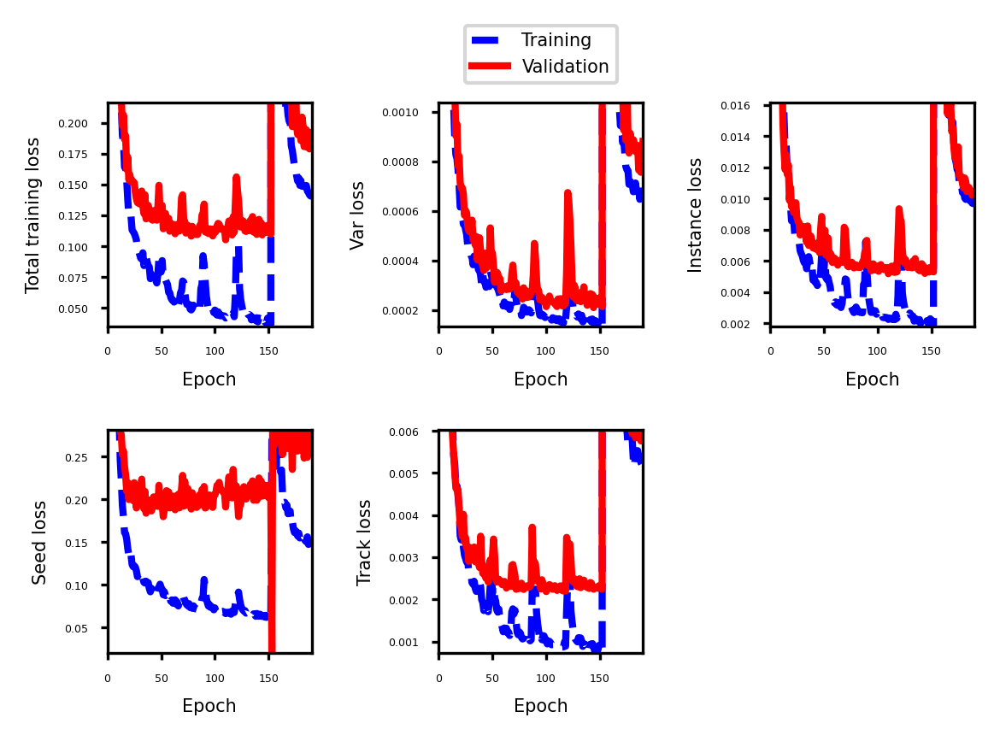

In [12]:
def plot_train_prog(ax, log_train, log_val, y_label):
    l0 = ax.plot(
        epochs, log_train, color="b", linewidth=2, linestyle="dashed",
        label="Training")
    l1 = ax.plot(epochs, log_val, color="r", linewidth=2, label="Validation")
    ax.set_xlabel("Epoch", fontsize=5)
    ax.set_ylabel(f"{y_label}", fontsize=5)
    ax.set_xlim(0, len(epochs) - 1)
    ax.set_ylim(
        min(min(log_train), min(log_val)) * 0.95,
        max(np.median(log_train) + 5 * median_abs_deviation(log_train),
            np.median(log_val) + 5 * median_abs_deviation(log_val)))
    return ax, l0, l1


logs = pd.read_csv(Path(trainer1a.logger.log_dir + "/metrics.csv"))
epochs = logs.dropna(subset=["train_loss"])["epoch"]

fig1, ax = plt.subplots(2, 3, figsize=(4, 3))
ax[0, 0], _, _ = plot_train_prog(
    ax[0, 0], logs["train_loss"].dropna(), logs["val_loss"].dropna(),
    "Total training loss")
ax[0, 1], l0, l1 = plot_train_prog(
    ax[0, 1], logs["train_var_loss"].dropna(), logs["val_var_loss"].dropna(),
    "Var loss")
ax[0, 1].legend(l0 + l1, [l.get_label() for l in l0 + l1], loc="lower center",
           bbox_to_anchor=(0, 1.05, 1, 0.2), ncol=1, fontsize=5)
ax[0, 2], _, _ = plot_train_prog(
    ax[0, 2],
    logs["train_instance_loss"].dropna(), logs["val_instance_loss"].dropna(),
    "Instance loss")
ax[1, 0], _, _ = plot_train_prog(
    ax[1, 0], logs["train_seed_loss"].dropna(), logs["val_seed_loss"].dropna(),
    "Seed loss")
ax[1, 1], _, _ = plot_train_prog(
    ax[1, 1], logs["train_track_loss"].dropna(),
    logs["val_track_loss"].dropna(), "Track loss")
fig1.delaxes(ax[1, 2])
plt.tight_layout()
plt.show()

In [13]:
checkpoint_file = trainer1a.checkpoint_callback.best_model_path

model001 = EmbedTrackModule.load_from_checkpoint(
    checkpoint_file, contractions=contractions, filter_init=filter_init,
    input_shape=resized_shape)

model001 = model001.embedtrack
_ = model001.eval()
torch.save(model001, "./model001.pt")

In [14]:
device = "cpu"
model001 = torch.load("./model001.pt", map_location="cpu")
_ = model001.eval()

Let's visualize the model outputs for one example:

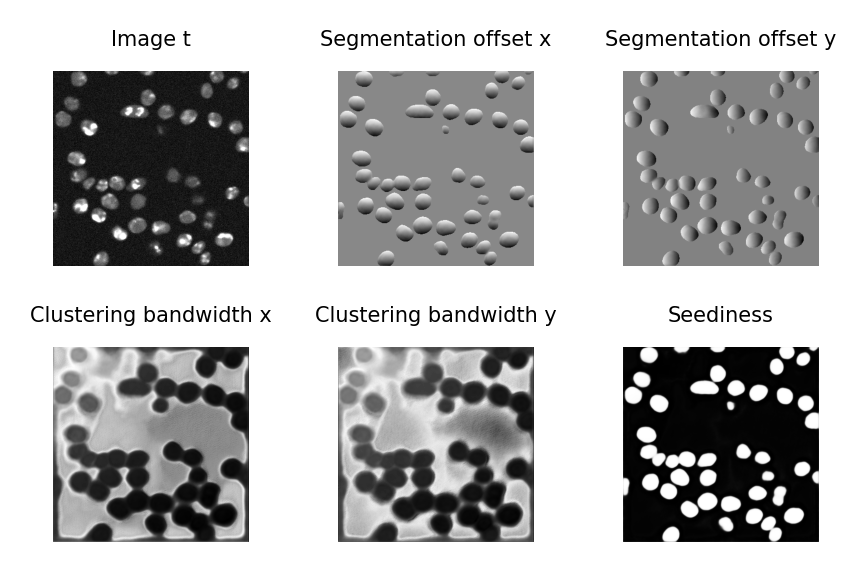

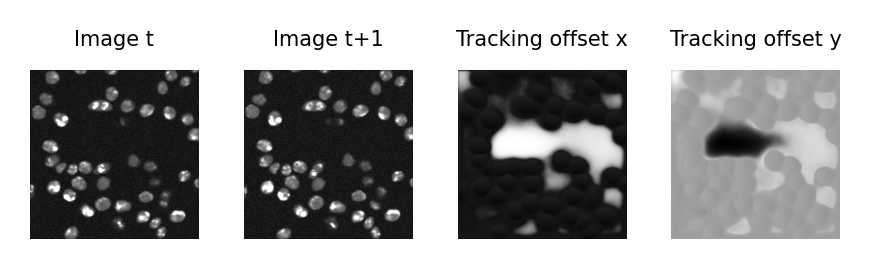

In [15]:
iterator = iter(loader_val)
img0, seg0_true, medoids0_true, img1, seg1_true, medoids1_true = next(iterator)
seg0_pred, seg1_pred, tra_pred = model001(
    img0[0:1, :, :, :], img1[0:1, :, :, :])

seed_mask0 = seg0_pred[0, 4, :, :].detach().numpy() > 0.5
seed_mask1 = seg1_pred[0, 4, :, :].detach().numpy() > 0.5

fig, ax = plt.subplots(2, 3, figsize=(3, 2))
ax[0, 0].imshow(img0[0, 0, :, :].detach().numpy(), cmap="gray", vmin=0, vmax=1)
ax[0, 0].set_title(f"Image t", fontsize=5)
ax[0, 1].imshow(
    seg0_pred[0, 0, :, :].detach().numpy() * seed_mask0, cmap="gray")
ax[0, 1].set_title(f"Segmentation offset x", fontsize=5)
ax[0, 2].imshow(
    seg0_pred[0, 1, :, :].detach().numpy() * seed_mask0, cmap="gray")
ax[0, 2].set_title(f"Segmentation offset y", fontsize=5)
ax[1, 0].imshow(seg0_pred[0, 2, :, :].detach().numpy(), cmap="gray")
ax[1, 0].set_title(f"Clustering bandwidth x", fontsize=5)
ax[1, 1].imshow(seg0_pred[0, 3, :, :].detach().numpy(), cmap="gray")
ax[1, 1].set_title(f"Clustering bandwidth y", fontsize=5)
ax[1, 2].imshow(seg0_pred[0, 4, :, :].detach().numpy(), cmap="gray")
ax[1, 2].set_title(f"Seediness", fontsize=5)
[axi.set_axis_off() for axi in ax.ravel()]
plt.tight_layout()
plt.show()

fig, ax = plt.subplots(1, 4, figsize=(3, 1))
ax[0].imshow(img0[0, 0, :, :].detach().numpy(), cmap="gray", vmin=0, vmax=1)
ax[0].set_title(f"Image t", fontsize=5)
ax[1].imshow(img1[0, 0, :, :].detach().numpy(), cmap="gray", vmin=0, vmax=1)
ax[1].set_title(f"Image t+1", fontsize=5)
ax[2].imshow(tra_pred[0, 0, :, :].detach().numpy(), cmap="gray")
ax[2].set_title(f"Tracking offset x", fontsize=5)
ax[3].imshow(tra_pred[0, 1, :, :].detach().numpy(), cmap="gray")
ax[3].set_title(f"Tracking offset y", fontsize=5)

[axi.set_axis_off() for axi in ax.ravel()]
plt.tight_layout()
plt.show()

During postprocessing, for instance segmentation we want to exclude the possibility of creating instances that are unrealistically small. Therefore, we calculate the areas of all instances in the training dataset:

In [16]:
mask_sizes = []
for i in range(len(ds_train)):
    _, seg0, _, _, _, _ = ds_train[i]
    seg0 = seg0.long()[0]
    seg0_ohe = F.one_hot(seg0)[:, :, 1:]
    mask_sizes_cur = seg0_ohe.sum(axis=(0, 1)).tolist()
    mask_sizes.extend([x for x in mask_sizes_cur if x != 0])

min_mask_size = np.percentile(
    np.sort(np.array(mask_sizes)), min_mask_size_percentile)
print(f"Minimal instance size considered during postprocessing (in px): {min_mask_size}")

Minimal instance size considered during postprocessing (in px): 49.34


Now, we define functions for the instance segmentation part of the postprocessing step as described in the EmbedTrack paper and apply and visualize this for one example:

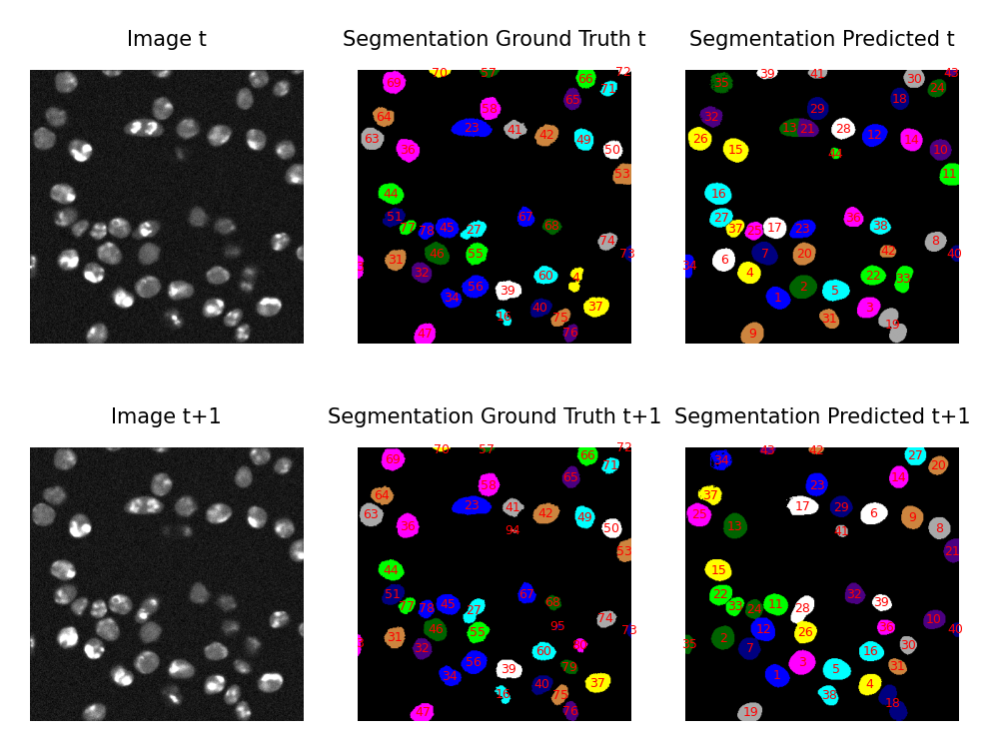

In [17]:
def unique(x, dim=0):
    # https://github.com/pytorch/pytorch/issues/36748#issuecomment-1452475373
    unique, inverse, counts = torch.unique(x, dim=dim,
        sorted=True, return_inverse=True, return_counts=True)
    inv_sorted = inverse.argsort(stable=True)
    tot_counts = torch.cat((counts.new_zeros(1), counts.cumsum(dim=0)))[:-1]
    index = inv_sorted[tot_counts]
    index = index.sort().values
    return unique, index, counts


def postprocess_segmentation(
    seg_pred, min_mask_size, seedines_cutoff, min_peak, w_s, maxiter=300):
    w, h = seg_pred.shape[1], seg_pred.shape[2]
    seed = seg_pred[4, :, : ]
    seed_mask = seed > seedines_cutoff

    pi = torch.stack(torch.meshgrid(
        torch.arange(w), torch.arange(h), indexing="ij")).float()
    pi[0, :, :] = pi[0, :, :] / (w - 1)
    pi[1, :, :] = pi[1, :, :] / (h - 1)
    eixy_norm = seg_pred[0:2, :, :] + pi
    eixy_norm = torch.clip(eixy_norm, 0, 1)
    eixy = deepcopy(eixy_norm)
    eixy[0, :, :] = eixy[0, :, :] * (w - 1)
    eixy[1, :, :] = eixy[1, :, :] * (h - 1)

    peaks = torch.cat(
        (eixy[0][seed_mask].reshape(-1, 1).int(),
         eixy[1][seed_mask].reshape(-1, 1).int()), axis=-1)
    idx, count = unique(peaks[:, [0, 1]], dim=0)[1:]
    peaks_list = torch.hstack((count[:, None], peaks[idx]))
    peak_map = torch.zeros((w, h))
    peak_map[peaks_list[:, 1], peaks_list[:, 2]] = peaks_list[:, 0].float()
    peak_map = F.conv2d(peak_map[None, None, :, :], torch.ones(1, 1, 3, 3),
                        padding=1)[0, 0, :, :]
    peak_list = torch.stack(torch.where(peak_map > min_peaks), axis=-1)
    idx_sort = torch.argsort(
        seed[peak_list[:, 0], peak_list[:, 1]], descending=True, stable=True)
    peak_list = peak_list[idx_sort]

    count = 0
    while True:
        count += 1
        peak = peak_list[0]
        if peak_list.shape[0] >= 1:
            peak_list = peak_list[1:]

        ejxy = torch.stack(
            (torch.full((w, h), eixy_norm[0, peak[0], peak[1]]),
             torch.full((w, h), eixy_norm[1, peak[0], peak[1]])))
        sjxy = torch.stack(
            (torch.full((w, h), seg_pred[2, peak[0], peak[1]]),
             torch.full((w, h), seg_pred[3, peak[0], peak[1]])))
        dji = torch.exp(
            - ((ejxy[0] - eixy_norm[0]).pow(2) / torch.exp(w_s * sjxy[0])) -
              ((ejxy[1] - eixy_norm[1]).pow(2) / torch.exp(w_s * sjxy[1])))

        try:
            dji_all = torch.cat((dji_all, dji[None, :, :]), axis=0)
        except Exception as e:
            dji_all = dji[None, :, :]

        mask_cur = (dji > seedines_cutoff) * seed_mask
        try:
            mask_cur_no_reassignment_needed = ~torch.max(
                mask, axis=0)[0] * mask_cur
            mask_cur_reassignment_cand = torch.max(mask, axis=0)[0] * mask_cur
            mask_cur_reassignment = (
                (torch.argmax(dji_all, axis=0) *
                 mask_cur_reassignment_cand) == (dji_all.shape[0] - 1))

            condition1 = (mask_cur_reassignment.sum() / (
                mask_cur_no_reassignment_needed.sum() +
                mask_cur_reassignment.sum())) < 0.5
            condition2 = (mask_cur_no_reassignment_needed.sum() +
                          mask_cur_reassignment.sum()) > min_mask_size
            if condition1 & condition2:
                mask_cur = (
                    mask_cur_no_reassignment_needed + mask_cur_reassignment)
                mask = mask * ~mask_cur_reassignment
                mask = torch.cat((mask, mask_cur[None, :, :]), axis=0)

                # Remove all pixels assigned to an instance from peak_list
                to_remove = torch.stack(torch.where(mask_cur), axis=-1)
                peak_list = peak_list[
                    ~(to_remove.unsqueeze(0) == peak_list.unsqueeze(1)
                    ).all(-1).any(-1)]

        except Exception as e:
            to_remove = torch.stack(torch.where(mask_cur), axis=-1)
            peak_list = peak_list[
                ~(to_remove.unsqueeze(0) == peak_list.unsqueeze(1)
                ).all(-1).any(-1)]
            mask = mask_cur[None, :, :]

        if peak_list.shape[0] == 0 or count >= maxiter:
            break
    return mask


seg0_pred_proc = postprocess_segmentation(
    seg0_pred[0, :, :, :].detach(), min_mask_size, seedines_cutoff,
    min_peaks, w_s_post)
seg1_pred_proc = postprocess_segmentation(
    seg1_pred[0, :, :, :].detach(), min_mask_size, seedines_cutoff,
    min_peaks, w_s_post)

fig, ax = plt.subplots(2, 3, figsize=(4, 3))
ax[0, 0].imshow(img0[0, 0, :, :].numpy(), cmap="gray", vmin=0, vmax=1)
ax[0, 0].set_title(f"Image t", fontsize=5)
ax[0, 1].imshow(colors_rgb[seg0_true[0, 0, :, :].numpy().astype(np.int32)])
ax[0, 1] = annotate_medoids(
    ax[0, 1], medoids0_true[0].numpy(), resized_shape[1], resized_shape[2], 3)
ax[0, 1].set_title(f"Segmentation Ground Truth t", fontsize=5)
ax[0, 2].imshow(colors_rgb[np.argmax(seg0_pred_proc.numpy(), axis=0)])
medoids0_pred_proc = get_instance_medoids(
    np.argmax(seg0_pred_proc.numpy(), axis=0))
ax[0, 2] = annotate_medoids(
    ax[0, 2], medoids0_pred_proc, resized_shape[1], resized_shape[2], 3)
ax[0, 2].set_title(f"Segmentation Predicted t", fontsize=5)

ax[1, 0].imshow(img1[0, 0, :, :].numpy(), cmap="gray", vmin=0, vmax=1)
ax[1, 0].set_title(f"Image t+1", fontsize=5)
ax[1, 1].imshow(colors_rgb[seg1_true[0, 0, :, :].numpy().astype(np.int32)])
ax[1, 1] = annotate_medoids(
    ax[1, 1], medoids1_true[0].numpy(), resized_shape[1], resized_shape[2], 3)
ax[1, 1].set_title(f"Segmentation Ground Truth t+1", fontsize=5)

ax[1, 2].imshow(colors_rgb[np.argmax(seg1_pred_proc.numpy(), axis=0)])
medoids1_pred_proc = get_instance_medoids(
    np.argmax(seg1_pred_proc.numpy(), axis=0))
ax[1, 2] = annotate_medoids(
    ax[1, 2], medoids1_pred_proc, resized_shape[1], resized_shape[2], 3)
ax[1, 2].set_title(f"Segmentation Predicted t+1", fontsize=5)
[axi.set_axis_off() for axi in ax.ravel()]
plt.show()

Instance segmentation seems to work, so let's get down to the tracking part. We will apply these to instance segmented masks from the cell above and see that the IDs of instances in the two images now align:

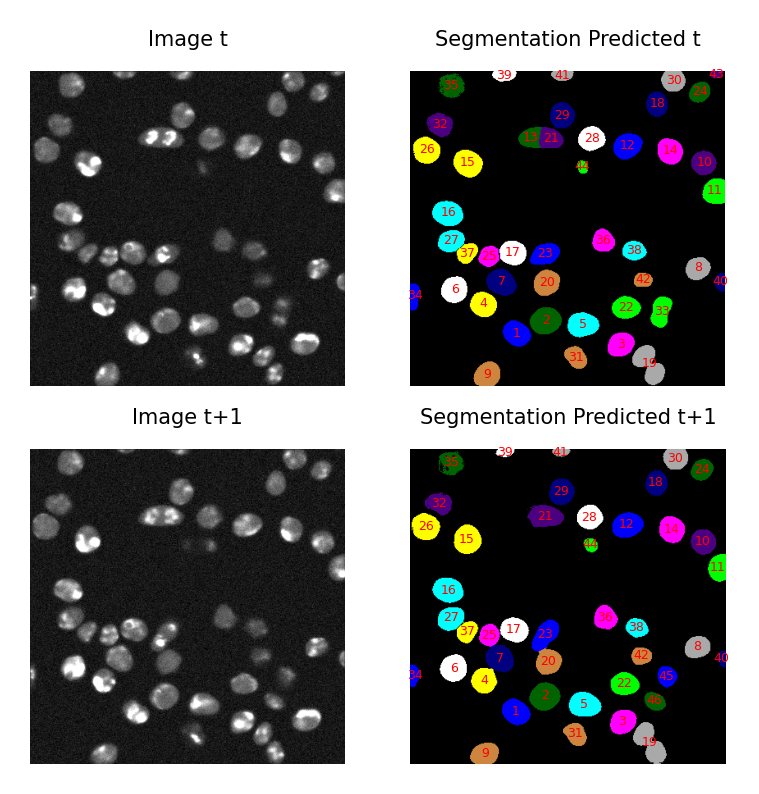

In [18]:
def postprocess_tracking(tra_pred, seg0_pred_proc, seg1_pred_proc):
    w, h = tra_pred.shape[1], tra_pred.shape[2]

    pi = torch.stack(torch.meshgrid(
        torch.arange(w), torch.arange(h), indexing="ij")).float().to(device)
    pi[0, :, :] = pi[0, :, :] / (w - 1)
    pi[1, :, :] = pi[1, :, :] / (h - 1)
    eixy_norm = tra_pred[0:2, :, :] + pi
    eixy_norm = torch.clip(eixy_norm, 0, 1)
    eixy = deepcopy(eixy_norm)
    eixy[0, :, :] = eixy[0, :, :] * (w - 1)
    eixy[1, :, :] = eixy[1, :, :] * (h - 1)

    src_all = []
    for idx0, mask in enumerate(seg1_pred_proc[0:, :, :]):
        peaks = torch.cat(
            (eixy[0][mask].reshape(-1, 1).int(),
             eixy[1][mask].reshape(-1, 1).int()), axis=-1)
        idx1, count1 = unique(peaks[:, [0, 1]], dim=0)[1:]
        peaks_list = torch.hstack((count1[:, None], peaks[idx1]))

        src1 = seg0_pred_proc[peaks_list[:, 1], peaks_list[:, 2]]
        src1 = torch.repeat_interleave(src1, count1)

        src2, _, count2 = unique(src1)
        src_all.append(src2[torch.argsort(count2, descending=True)][0].item())

    counts_all = [src_all.count(x) for x in src_all]
    out = torch.zeros((w, h))
    new_id = torch.max(seg0_pred_proc) + 1
    for idx0, mask in enumerate(seg1_pred_proc[0:, :, :]):
        if counts_all[idx0] == 1:
            out[mask != 0] = src_all[idx0]
        else:
            out[mask != 0] = new_id
            new_id += 1
    return out.int()


seg1_pred_proc2 = postprocess_tracking(
    tra_pred[0, :, :, :].detach(), torch.argmax(seg0_pred_proc.long(), axis=0),
    seg1_pred_proc)

fig, ax = plt.subplots(2, 2, figsize=(3, 3))
ax[0, 0].imshow(img0[0, 0, :, :].numpy(), cmap="gray", vmin=0, vmax=1)
ax[0, 0].set_title(f"Image t", fontsize=5)
ax[0, 1].imshow(colors_rgb[np.argmax(seg0_pred_proc.numpy(), axis=0)])
medoids0_pred_proc = get_instance_medoids(
    np.argmax(seg0_pred_proc.numpy(), axis=0))
ax[0, 1] = annotate_medoids(
    ax[0, 1], medoids0_pred_proc, resized_shape[1], resized_shape[2], 3)
ax[0, 1].set_title(f"Segmentation Predicted t", fontsize=5)

ax[1, 0].imshow(img1[0, 0, :, :].numpy(), cmap="gray", vmin=0, vmax=1)
ax[1, 0].set_title(f"Image t+1", fontsize=5)
ax[1, 1].imshow(colors_rgb[seg1_pred_proc2.numpy()])
medoids1_pred_proc = get_instance_medoids(seg1_pred_proc2.numpy())
ax[1, 1] = annotate_medoids(
    ax[1, 1], medoids1_pred_proc, resized_shape[1], resized_shape[2], 3)
ax[1, 1].set_title(f"Segmentation Predicted t+1", fontsize=5)
[axi.set_axis_off() for axi in ax.ravel()]
plt.show()

Finally, let's try this out on a longer sequence. We will look at a sequence of 40 frames from the test data and create a gif animation from this:

In [19]:
def preprocess(fp_img, resized_shape):
    img = skio.imread(fp_img)

    # Resize image and mask
    transform = A.Compose([A.Resize(resized_shape[1], resized_shape[2])])
    transformed = transform(image=img)
    img = transformed["image"]

    # Normalize image
    min_img, max_img = np.quantile(img, [0.01, 0.99])
    img = ((img - min_img) / (max_img - min_img)).astype(np.float32)
    img = np.clip(img, 0, 1)
    return torch.tensor(img).float()


dir_test_img_seq = dir_test + "Fluo-N2DH-SIM+/01/"
fps_img_test = sorted(glob.glob(dir_test_img_seq + "*.tif"))
animation_frames = []

for idx, _ in enumerate(fps_img_test[0:40]):
    img0 = preprocess(fps_img_test[idx], resized_shape)[None, None, :, :]
    img1 = preprocess(fps_img_test[idx+1], resized_shape)[None, None, :, :]
    seg0_pred, _, tra_pred = model001(img0, img1)

    seg0_pred_proc = postprocess_segmentation(
        seg0_pred[0, :, :, :].detach(), min_mask_size, seedines_cutoff,
        min_peaks, w_s_post)

    if idx == 0:
        prev = torch.argmax(seg0_pred_proc.long(), axis=0)
    else:
        seg0_pred_proc = postprocess_tracking(
            tra_pred[0, :, :, :].detach(),
            prev,
            seg0_pred_proc)
        prev = seg0_pred_proc


    fig, ax = plt.subplots(1, 2, figsize=(3, 1.5))
    ax[0].imshow(img0.numpy()[0, 0, :, :], cmap="gray", vmin=0, vmax=1)
    ax[1].imshow(colors_rgb[prev])
    medoids0_pred_proc = get_instance_medoids(
        prev)
    ax[1] = annotate_medoids(
        ax[1], medoids0_pred_proc, resized_shape[1], resized_shape[2], 3)
    [axi.set_axis_off() for axi in ax.ravel()]
    fig.suptitle(f"Frame {idx}", fontsize=7)
    plt.close()

    animation_frames.append(fig2PngImageFile(fig))

animation_frames[0].save(
    "./animation_seq_test.gif", save_all=True,
    append_images=animation_frames[0:], fps=10, loop=0)

InteractiveShell.ast_node_interactivity = "all"

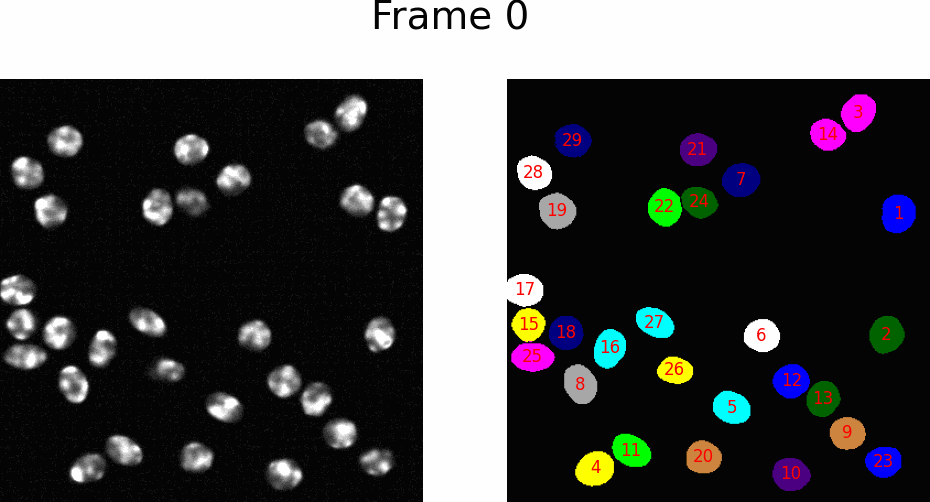

In [20]:
with open("./animation_seq_test.gif", "rb") as f:
    display.Image(data=f.read(), format="gif")

InteractiveShell.ast_node_interactivity = "last_expr"

![display image](./animation_seq_test.gif)